# Notebook - TCC

In [ ]:
import pandas as pd
import geopandas as gpd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium
import io
import json
import copy
from folium.plugins import Search

In [ ]:
pip install jenkspy

# **Funçoes principais**

In [ ]:
# Função para calcular a classe da cidade com base na população
def calcular_classe(populacao):
    if 0 <= populacao <= 250000:
        return 1
    elif 250000 < populacao <= 500000:
        return 2
    elif 500000 < populacao <= 1500000:
        return 3
    else:
        return 4

In [ ]:
# Função para calcular a classe da cidade com base na população segundo IBGE
def calcular_classe_ibge(populacao):
    if 0 <= populacao <= 99000:
        return 1
    elif 99000 < populacao <= 499000:
        return 2
    elif 499000 < populacao <= 9999999:
        return 3
    else:
        return 4

In [ ]:
# Definição de classes municipais por nível populacional segundo IBGE
classe_municipios_ibge = "Cidade pequena", "Cidade média", "Cidade grande", "Megacidade"
mapper_ibge = {i+1 :x for i, x in enumerate(classe_municipios_ibge)}

In [ ]:
# Definição de classes municipais por nível populacional
classe_municipios = "0 - 250k", "250k - 500k", "500k - 1500k", "1500k - ..."
mapper = {i+1 :x for i, x in enumerate(classe_municipios)}

In [ ]:
# Função para calcular a classe da cidade com base na balança de internações
def calcular_balanca_internacoes(balanca):
    if balanca < 0:
        return 1
    else:
        return 2

In [ ]:
# Definição de classes municipais por balanca de internações
classe_balanca_internacoes = "Negativa", "Positiva"
mapper_internacoes = {i+1 :x for i, x in enumerate(classe_balanca_internacoes)}

In [ ]:
def plotMap(dados, coluna1, coluna2, legenda, dict_used, ):

  geoData = copy.deepcopy(sp_cities)

  map = folium.Map(
    location=[-23.6814347,-46.9249399],
    control_scale=True,
    zoom_start=7)

  dadosMapa = folium.Choropleth(
    geo_data=geoData,
    name='choropleth',
    data=dados,
    columns=[coluna1, coluna2],
    key_on='feature.properties.id',
    fill_color= 'YlOrRd',#'RdYlGn', YlOrRd
    bins=6,
    use_jenks=True,
    fill_opacity=1,
    line_opacity=0.2,
    smooth_factor=0,
    Highlight= False,
    line_color = "Black",
    show=False,
    overlay=False,
    nan_fill_color = "White",
    legend_name=legenda
  ).add_to(map)

  # looping through the geojson object and adding a new property(coluna2)
  # and assigning a value from our dataframe
  for s in dadosMapa.geojson.data['features']:
    try:
      s['properties'][coluna2] = dict_used.loc[s['properties']['id'], coluna2]
    except KeyError:
      s['properties'][coluna2] = None

  highlight_function = lambda x: {'fillColor': '#000000',
                                  'color':'#000000',
                                  'fillOpacity': 0.50,
                                  'weight': 0.1}
  style_function = lambda x: {
    'color' : 'white',
    'opacity' : 0,
    'weight' : '2'
  }
  map_style = folium.features.GeoJson(
      dadosMapa.geojson.data,
      control=False,
      style_function = style_function,
      highlight_function=highlight_function,
      tooltip=folium.features.GeoJsonTooltip(
          fields=['name',coluna2],
          aliases=[ coluna1 + ': ', legenda],
          style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
      )
  ).add_to(map)

  citysearch = Search(
    layer=map_style,
    geom_type="Point",
    placeholder="Search for a US City",
    collapsed=True,
    search_label="name",
  ).add_to(map)


  return map


In [ ]:
def plotDualMap(dados, coluna1, coluna2, legenda, dict_used):

  mapa = folium.plugins.DualMap(location=(-24, -47), zoom_start=7)
  geoData = copy.deepcopy(sp_cities)

  for x in range(1, 3):
    if(x == 1):
      map = mapa.m1
      coluna = coluna1
      legenda = coluna1
    else:
      map = mapa.m2
      coluna = coluna2
      legenda = coluna2

    dadosMapa = folium.Choropleth(
    geo_data=geoData,
    name='choropleth',
    data=dados,
    columns=['Município', coluna],
    key_on='feature.properties.id',
    fill_color='YlOrRd',
    bins=6,
    use_jenks=True,
    fill_opacity=1,
    line_opacity=0.2,
    smooth_factor=0,
    Highlight= False,
    line_color = "Black",
    show=False,
    overlay=False,
    nan_fill_color = "White",
    legend_name=legenda
    ).add_to(map)

    # looping through the geojson object and adding a new property(coluna2)
    # and assigning a value from our dataframe
    for s in dadosMapa.geojson.data['features']:
      try:
        s['properties'][coluna] = dict_used.loc[s['properties']['id'], coluna]
      except KeyError:
        s['properties'][coluna] = None

    highlight_function = lambda x: {'fillColor': '#000000',
                                    'color':'#000000',
                                    'fillOpacity': 0.50,
                                    'weight': 0.1}
    style_function = lambda x: {
      'color' : 'white',
      'opacity' : 0,
      'weight' : '2'
    }
    map_style = folium.features.GeoJson(
        dadosMapa.geojson.data,
        control=False,
        style_function = style_function,
        highlight_function=highlight_function,
        tooltip=folium.features.GeoJsonTooltip(
            fields=['name',coluna],
            aliases=['Município: ', legenda],
            style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
        )
    ).add_to(map)

  return mapa

# **Dados População dos municípios de SP**

In [ ]:
PopSp2022 = pd.DataFrame(pd.read_csv('censo2022_populacao.csv', encoding = 'latin-1', sep=';', on_bad_lines='skip'))

In [ ]:
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str).str[:-1].astype(int)

In [ ]:
PopSp2022 = PopSp2022.drop(index = 0)

In [ ]:
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str)
PopSp2022['censo2022'] = PopSp2022['censo2022'].astype(float)
PopSp2022_dict = PopSp2022.set_index('cod_ibge')

In [ ]:
plotMap(PopSp2022, 'cod_ibge', 'censo2022', 'Habitantes', PopSp2022_dict)

# **GeoJson estado de SP**

In [ ]:
dados = open('coordenadasMunicipiosSP.json')

In [ ]:
sp_cities = json.load(dados)

In [ ]:
# Corrigir o campo "id" no GeoJSON
for feature in sp_cities['features']:
    id_geojson = feature['properties']['id']
    feature['properties']['id'] = id_geojson[:6]  # Manter apenas os 6 primeiros dígitos

# **Dados Saúde - Médicos por município no estado de SP**

In [ ]:
médicosMunicipio = pd.read_csv('Quan. Médicos_Município.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')

In [ ]:
médicosMunicipio['Município'] = médicosMunicipio['Município'].str.replace('\D', '').str.replace(' ', '')
médicosMunicipio.columns = médicosMunicipio.columns.str.replace('^Médico', '')

In [ ]:
medicos_municipio = pd.DataFrame(médicosMunicipio)
medicos_municipio = medicos_municipio.drop(medicos_municipio.index[-1])

**Taxa - Médicos/1000 habitantes**

In [ ]:
medicos_municipio['Município'] = medicos_municipio['Município'].astype(str)
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str)

In [ ]:
# Mesclar os DataFrames
taxa_medicos_habitante = pd.merge(medicos_municipio, PopSp2022, left_on='Município', right_on='cod_ibge')
# Selecionar apenas as colunas desejadas
colunas_desejadas = ['Município', 'Total', 'censo2022']
taxa_medicos_habitante = taxa_medicos_habitante[colunas_desejadas]
# Calcular a quantidade de médicos por cada mil habitantes
taxa_medicos_habitante['Medicos_por_1000_hab'] = (taxa_medicos_habitante['Total'] / (taxa_medicos_habitante['censo2022'] / 1000)).round(2)

In [ ]:
medicos_dict = taxa_medicos_habitante.set_index('Município')

**Configuração do Mapa do estado de SP - Médicos / 1000 habitantes**

In [ ]:
maiores_taxas = taxa_medicos_habitante.sort_values(by='Medicos_por_1000_hab', ascending=False)

In [ ]:
maiores_taxas.head(10)

In [ ]:
maiores_taxas['censo2022'].head(10).mean()

In [ ]:
plotMap(taxa_medicos_habitante, 'Município', 'Medicos_por_1000_hab', 'Médicos a cada 1000 habitantes', medicos_dict)

# **Dados Saúde - Médicos por município por Tipo de Prestação**

In [ ]:
atendem = pd.read_csv('medicos_atendem.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')
nao_atendem = pd.read_csv('medicos_nao_atendem.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')

In [ ]:
atendem['Município'] = atendem['Município'].str.replace('\D', '').str.replace(' ', '')
nao_atendem['Município'] = nao_atendem['Município'].str.replace('\D', '').str.replace(' ', '')

In [ ]:
colunas = ['Município', 'Total']
atendem = atendem[colunas]
nao_atendem = nao_atendem[colunas]

In [ ]:
atendem = atendem.dropna()
nao_atendem = nao_atendem.dropna()
atendem = atendem.drop(atendem.index[-1])
nao_atendem = nao_atendem.drop(nao_atendem.index[-1])

In [ ]:
medicos_municipio_prestacao = pd.merge(atendem, nao_atendem, on='Município', how='left')
medicos_municipio_prestacao = medicos_municipio_prestacao.rename(columns={'Total_x': 'Sim', 'Total_y': 'Não'})

**Taxa - Médicos/1000 habitantes**

In [ ]:
medicos_municipio_prestacao['Município'] = medicos_municipio_prestacao['Município'].astype(str)
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str)

In [ ]:
# Mesclar os DataFrames
taxa_prestador_habitante = pd.merge(medicos_municipio_prestacao, PopSp2022, left_on='Município', right_on='cod_ibge')
# Selecionar apenas as colunas desejadas
colunas_desejadas = ['Município', 'Sim','Não', 'censo2022']
taxa_prestador_habitante = taxa_prestador_habitante[colunas_desejadas]
taxa_prestador_habitante = taxa_prestador_habitante.replace('-', np.nan)
# Calcular a quantidade de médicos por cada mil habitantes
taxa_prestador_habitante.iloc[:, 1:3] = taxa_prestador_habitante.iloc[:, 1:3].astype(float)
taxa_prestador_habitante.iloc[:, 1:3] = taxa_prestador_habitante.iloc[:, 1:3].div((taxa_prestador_habitante['censo2022'] / 1000), axis=0).round(2)

In [ ]:
prestacao_dict = taxa_prestador_habitante.set_index('Município')

In [ ]:
df_combined = pd.merge(renda_dict, prestacao_dict, on='Município')

In [ ]:
maiores_taxas_prestacao = df_combined.sort_values(by='Não', ascending=False)

In [ ]:
maiores_taxas_prestacao.head(10)

In [ ]:
maiores_taxas_prestacao['Renda_média_domic._per_capita'].head(10).mean()

In [ ]:
plotMap(taxa_prestador_habitante, 'Município', 'Não', 'Atende pelo SUS', prestacao_dict)

**Configuração do Mapa do estado de SP - Prestador / 1000 habitantes**

In [ ]:
plotDualMap(taxa_prestador_habitante, 'Sim', 'Não', 'Atende pelo SUS', prestacao_dict)

# **Dados Saúde - Quantidade de Hospitais/Pronto-Socorro gerais por município - 2022**


In [ ]:
hospitaisMunicipio = pd.read_csv('Hospitais_municipio.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')

In [ ]:
hospitaisMunicipio['Município'] = hospitaisMunicipio['Município'].str.replace('\D', '').str.replace(' ', '')

In [ ]:
hospitais_municipio = pd.DataFrame(hospitaisMunicipio)
hospitais_municipio = hospitais_municipio.dropna(axis=0)
hospitais_municipio = hospitais_municipio.drop(hospitais_municipio.index[-1])

**Taxa - Hospitais/1000 habitantes**

In [ ]:
hospitais_municipio['Município'] = hospitais_municipio['Município'].astype(str)
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str)

In [ ]:
# Mesclar os DataFrames
taxa_hospitais_habitante = pd.merge(hospitais_municipio, PopSp2022, left_on='Município', right_on='cod_ibge')
# Selecionar apenas as colunas desejadas
taxa_hospitais_habitante = taxa_hospitais_habitante.loc[:, ['Município', 'Total', 'censo2022']]
# Calcular a quantidade de hospitais por cada mil habitantes
taxa_hospitais_habitante['Hospitais_por_1000_hab'] = (taxa_hospitais_habitante['Total'] / (taxa_hospitais_habitante['censo2022'] / 1000)).round(2)

In [ ]:
hospitais_dict = taxa_hospitais_habitante.set_index('Município')

**Configuração do Mapa do estado de SP - Hospitais / 1000 habitantes**

In [ ]:
plotMap(taxa_hospitais_habitante, 'Município', 'Hospitais_por_1000_hab', 'Hospitais a cada 1000 habitantes', hospitais_dict)

# **Dados Saúde - Quantidade de estabelecimentos por município - 2022**


In [ ]:
estabelecimentosMunicipio = pd.read_csv('Estabelecimentos_saude_municipio.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')

In [ ]:
estabelecimentosMunicipio['Município'] = estabelecimentosMunicipio['Município'].str.replace('\D', '').str.replace(' ', '')

In [ ]:
estabelecimentos_municipio = pd.DataFrame(estabelecimentosMunicipio)
estabelecimentos_municipio = estabelecimentos_municipio.dropna(axis=0)
estabelecimentos_municipio = estabelecimentos_municipio.drop(estabelecimentos_municipio.index[-1])

**Taxa - Estabelecimentos/1000 habitantes**

In [ ]:
estabelecimentos_municipio['Município'] = estabelecimentos_municipio['Município'].astype(str)
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str)

In [ ]:
# Mesclar os DataFrames
taxa_estabelecimentos_habitante = pd.merge(estabelecimentos_municipio, PopSp2022, left_on='Município', right_on='cod_ibge')
# Selecionar apenas as colunas desejadas
taxa_estabelecimentos_habitante = taxa_estabelecimentos_habitante.loc[:, ['Município', 'Total', 'censo2022']]
# Calcular a quantidade de casos suspeitos por cada mil habitantes
taxa_estabelecimentos_habitante['Estabelecimentos_por_1000_hab'] = (taxa_estabelecimentos_habitante['Total'] / (taxa_estabelecimentos_habitante['censo2022'] / 1000)).round(2)
#taxa_estabelecimentos_habitante['Estabelecimentos_por_1000_hab'] = ((taxa_estabelecimentos_habitante['HOSPITAL GERAL'] + taxa_estabelecimentos_habitante['HOSPITAL ESPECIALIZADO'] + taxa_estabelecimentos_habitante['PRONTO SOCORRO GERAL'] + taxa_estabelecimentos_habitante['PRONTO SOCORRO ESPECIALIZADO']) / (taxa_estabelecimentos_habitante['censo2022'] / 1000)).round(2)

In [ ]:
estabelecimentos_dict = taxa_estabelecimentos_habitante.set_index('Município')

In [ ]:
df_combined = pd.merge(renda_dict, estabelecimentos_dict, on='Município')
#df_combined = df_combined.drop('Total', axis=1)

In [ ]:
df_combined['IDHM 2010'] = df_combined['IDHM 2010'].astype(float)
colunas = ['IDHM 2010','Total', 'Estabelecimentos_por_1000_hab', 'censo2022' ]
df_combined = df_combined[colunas]

In [ ]:
maiores_taxas_prestacao = df_combined.sort_values(by='Estabelecimentos_por_1000_hab', ascending=False)

In [ ]:
maiores_taxas_prestacao.head(10)

In [ ]:
maiores_taxas_prestacao['Renda_média_domic._per_capita'].head(10).mean()

**Configuração do Mapa do estado de SP - Estabelecimentos por município**

In [ ]:
plotMap(taxa_estabelecimentos_habitante, 'Município', 'Estabelecimentos_por_1000_hab', 'Estabelecimentos de saúde', estabelecimentos_dict)

# **Dados Saúde - Despesa por município - 2022**


In [ ]:
despesaMunicipio = pd.read_csv('tipoDespesa_municipio_2006.csv', encoding = 'latin-1' , sep=';', on_bad_lines='skip')
despesaMunicipio['Município'] = despesaMunicipio['Município'].str.replace('\D', '').str.replace(' ', '')
despesa_municipio = pd.DataFrame(despesaMunicipio)
despesa_municipio = despesa_municipio.dropna(axis=0)
#despesa_municipio = despesa_municipio.drop(despesa_municipio.index[-1])
despesa_municipio = despesa_municipio.iloc[:-2]

**Taxa - Valor/1000 habitantes**

In [ ]:
despesa_municipio['Total'] = [x[:-2] for x in despesa_municipio['Total']] # Tive que usar esse método para remover os últimos dois caracteres, o dataframe é do tipo series
despesa_municipio['Total'] = despesa_municipio['Total'].str.replace(',', '')

In [ ]:
despesa_municipio['Município'] = despesa_municipio['Município'].astype(str)
despesa_municipio['Total'] = despesa_municipio['Total'].astype(float)
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str)
# Mesclar os DataFrames
taxa_despesa_habitante = pd.merge(despesa_municipio, PopSp2022, left_on='Município', right_on='cod_ibge')
# Selecionar apenas as colunas desejadas
taxa_despesa_habitante = taxa_despesa_habitante.loc[:, ['Município', 'Total', 'censo2022']]
# Calcular o valor despendido a cada mil habitantes
taxa_despesa_habitante['Valor_por_1000_hab'] = (taxa_despesa_habitante['Total'] / (taxa_despesa_habitante['censo2022'] / 1000)).round(2)
despesa_dict = taxa_despesa_habitante.set_index('Município')

In [ ]:
df_combined = pd.merge(estabelecimentos_dict, despesa_dict, on='Município')
colunas = ['Estabelecimentos_por_1000_hab', 'Valor_por_1000_hab', 'censo2022_x', 'Total_x']
df_combined = df_combined[colunas]
df_combined = df_combined.rename(columns={'censo2022_x': 'censo2022', 'Total_x': 'Total'})
x = df_combined['Estabelecimentos_por_1000_hab']
y = df_combined['Valor_por_1000_hab']
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

In [ ]:
correlation = df_combined.corr()
correlation

In [ ]:
df_combined = pd.merge(idhm_dict, despesa_dict, on='Município')

In [ ]:
df_combined['IDHM 2010'] = df_combined['IDHM 2010'].astype(float)
colunas = ['IDHM 2010','Total', 'Valor_por_1000_hab', 'censo2022' ]
df_combined = df_combined[colunas]

In [ ]:
maiores_taxas_despesa = df_combined.sort_values(by='Valor_por_1000_hab', ascending=False)

In [ ]:
maiores_taxas_despesa.head(10)

In [ ]:
maiores_taxas_despesa['IDHM 2010'].head(10).mean()

In [ ]:
df_combined = pd.merge(medicos_dict, despesa_dict, on='Município')
colunas = ['Medicos_por_1000_hab', 'Valor_por_1000_hab', 'censo2022_x', 'Total_x']
df_combined = df_combined[colunas]
df_combined = df_combined.rename(columns={'censo2022_x': 'censo2022', 'Total_x': 'Total'})
x = df_combined['Medicos_por_1000_hab']
y = df_combined['Valor_por_1000_hab']
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

In [ ]:
correlation = df_combined.corr()
correlation

In [ ]:
df_combined = pd.merge(df_deslocamento_dict, despesa_dict, on='Município')
colunas = ['Internação', 'Balança', 'Valor_por_1000_hab', 'Total']
df_combined = df_combined[colunas]

In [ ]:
correlation = df_combined.corr()
correlation

**Configuração do Mapa do estado de SP - Valor despendido por município**

In [ ]:
plotMap(taxa_despesa_habitante, 'Município', 'Valor_por_1000_hab', 'Despesa de saúde', despesa_dict)

# **Dados Saúde - Suspeitas Dengue por município e escolaridade - 2022**

In [ ]:
dengue_notificacao = pd.DataFrame(pd.read_csv('Dengue - Notificacao_Municipio_Escolaridade_2022.csv', encoding = 'latin-1', sep=';', on_bad_lines='skip'))

In [ ]:
dengue_notificacao.rename(columns={'Município de notificação': 'Município'}, inplace=True)
dengue_notificacao['Município'] = dengue_notificacao['Município'].str.replace('\D', '').str.replace(' ', '')
dengue_notificacao = dengue_notificacao.dropna(axis=0)
dengue_notificacao = dengue_notificacao[dengue_notificacao['Município'].str.startswith('35')]

 **Taxa - Suspeitas/1000 habitantes**

In [ ]:
dengue_notificacao['Município'] = dengue_notificacao['Município'].astype(str)
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str)

In [ ]:
# Mesclar os DataFrames
taxa_dengue_habitante = pd.merge(dengue_notificacao, PopSp2022, left_on='Município', right_on='cod_ibge')
# Selecionar apenas as colunas desejadas
taxa_dengue_habitante = taxa_dengue_habitante.loc[:, ['Município', 'Total', 'censo2022']]
# Calcular a quantidade de casos suspeitos por cada mil habitantes
taxa_dengue_habitante['Suspeitas_por_1000_hab'] = (taxa_dengue_habitante['Total'] / (taxa_dengue_habitante['censo2022'] / 1000)).round(2)

In [ ]:
dengue_dict = taxa_dengue_habitante.set_index('Município')

**Configuração do Mapa do estado de SP - Notificação Dengue**

In [ ]:
plotMap(taxa_dengue_habitante, 'Município', 'Suspeitas_por_1000_hab', 'Casos suspeitos de dengue', dengue_dict)

# **Dados Saúde - Renda Domiciliar per capita - 2010**

In [ ]:
renda_domicilio = pd.DataFrame(pd.read_csv('Renda_domiciliar_capita_2010.csv', encoding = 'latin-1', sep=';', on_bad_lines='skip'))

In [ ]:
renda_domicilio['Município'] = renda_domicilio['Município'].str.replace('\D', '').str.replace(' ', '')
renda_domicilio = renda_domicilio.dropna(axis=0)

<ipython-input-71-6b758fad7ced>:1: FutureWarning: The default value of regex will change from True to False in a future version.
  renda_domicilio['Município'] = renda_domicilio['Município'].str.replace('\D', '').str.replace(' ', '')


In [ ]:
renda_domicilio['Renda_média_domic._per_capita'] = renda_domicilio['Renda_média_domic._per_capita'].str.replace(',', '.')
renda_domicilio['Renda_média_domic._per_capita'] = renda_domicilio['Renda_média_domic._per_capita'].astype(float)
renda_domicilio = renda_domicilio.drop(renda_domicilio.index[-1])

In [ ]:
renda_domicilio

In [ ]:
renda_dict = renda_domicilio.set_index('Município')

In [ ]:
df_combined = pd.merge(idhm_dict, renda_dict, on='Município').merge(estabelecimentos_dict, on='Município')

In [ ]:
df_combined['IDHM 2010'] = df_combined['IDHM 2010'].astype(float)
colunas = ['IDHM 2010', 'Renda_média_domic._per_capita', 'censo2022' ]
df_combined = df_combined[colunas]

In [ ]:
maiores_taxas_despesa = df_combined.sort_values(by='Renda_média_domic._per_capita', ascending=False)

In [ ]:
maiores_taxas_despesa.head(10)

In [ ]:
maiores_taxas_despesa['Renda_média_domic._per_capita'].head(10).mean()

Configuração do Mapa do estado de SP - Notificação Dengue

In [ ]:
plotMap(renda_domicilio, 'Município', 'Renda_média_domic._per_capita', 'Renda domiciliar', renda_dict)

# **Dados Saúde - Moradores sem acesso a instalações sanitarias - 2010**

In [ ]:
ins_sanitarias = pd.DataFrame(pd.read_csv('Moradores_Instalações_sanitárias_2010.csv', encoding = 'latin-1', sep=';', on_bad_lines='skip'))

In [ ]:
ins_sanitarias['Município'] = ins_sanitarias['Município'].str.replace('\D', '').str.replace(' ', '')
ins_sanitarias = ins_sanitarias.dropna(axis=1) #remove colunas com valores NaN
#ins_sanitarias['Total'] = ins_sanitarias['Total'].astype(float)

 **Taxa - Porcentagem da população sem acesso a saneamento sanitário**

In [ ]:
ins_sanitarias['Município'] = ins_sanitarias['Município'].astype(str)
PopSp2022['cod_ibge'] = PopSp2022['cod_ibge'].astype(str)

In [ ]:
# Mesclar os DataFrames
taxa_saneamento = pd.merge(ins_sanitarias, PopSp2022, left_on='Município', right_on='cod_ibge')
# Selecionar apenas as colunas desejadas
taxa_saneamento = taxa_saneamento.loc[:, ['Município', 'Total', 'censo2010']]
# Calcular a porcentagem da população com acesso a saneamento
taxa_saneamento['porcentagem_saneamento'] = 100 - (((taxa_saneamento['Total'] / (taxa_saneamento['censo2010']) * 100)).round(2))

In [ ]:
taxa_saneamento_dict = taxa_saneamento.set_index('Município')

**Configuração do Mapa do estado de SP - Saneamento sanitário**

In [ ]:
plotMap(taxa_saneamento, 'Município', 'porcentagem_saneamento', 'Acesso a rede sanitária', taxa_saneamento_dict)

# **Análise Correlacional - Dist. profissional / Rend. Dom. per capita**

In [ ]:
df_combined = pd.merge(renda_dict, medicos_dict, on='Município')

x = df_combined['Renda_média_domic._per_capita']
y = df_combined['Medicos_por_1000_hab']
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)
df_combined['classe_cidade_ibge'] = df_combined['censo2022'].apply(calcular_classe_ibge)
df_combined['classe_cidade_ibge'] = df_combined['classe_cidade_ibge'].map(mapper_ibge)

In [ ]:
correlation = df_combined.corr()
correlation

<ipython-input-152-db6e5524fe44>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = df_combined.corr()


,Renda_média_domic._per_capita,Total,censo2022,Medicos_por_1000_hab
Renda_média_domic._per_capita,1.000000,0.262608,0.259755,0.480376
Total,0.262608,1.000000,0.993497,0.192551
censo2022,0.259755,0.993497,1.000000,0.168226
Medicos_por_1000_hab,0.480376,0.192551,0.168226,1.000000


In [ ]:
df_combined['Correlacao'] = df_combined['Renda_média_domic._per_capita']*df_combined['Medicos_por_1000_hab']

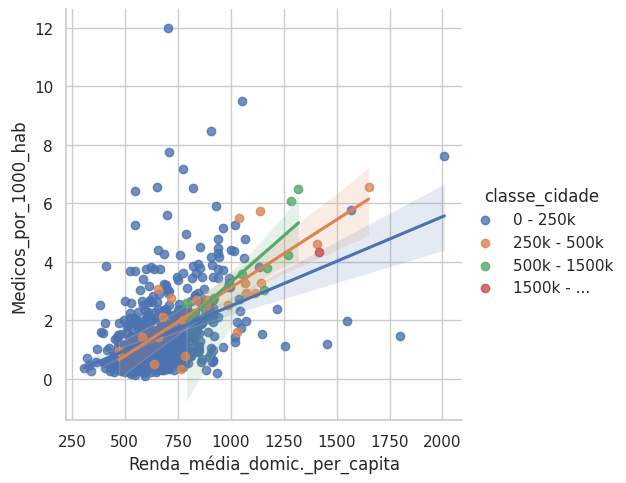

In [ ]:
sns.lmplot(x='Renda_média_domic._per_capita', y='Medicos_por_1000_hab', data=df_combined, hue='classe_cidade', fit_reg=True)


### Mapa Correlacional

In [ ]:
df_combined.reset_index(inplace=True)
df_combined['Correlacao'] = (df_combined['Correlacao'] / 100).round(2)

In [ ]:
df_combined_dict = df_combined.set_index('Município')

In [ ]:
plotMap(df_combined, 'Município', 'Correlacao', 'Correlacao Médicos / Renda', df_combined_dict)

### Médicos por prestação x Renda

In [ ]:
df_combined = pd.merge(renda_dict, prestacao_dict, on='Município')
df_combined['classe_cidade'] = df_combined['censo2022'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

In [ ]:
correlation = df_combined.corr()
correlation

<ipython-input-53-db6e5524fe44>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = df_combined.corr()


,Renda_média_domic._per_capita,Sim,Não,censo2022
Renda_média_domic._per_capita,1.000000,0.044412,0.601804,0.256361
Sim,0.044412,1.000000,0.129730,-0.004774
Não,0.601804,0.129730,1.000000,0.241600
censo2022,0.256361,-0.004774,0.241600,1.000000


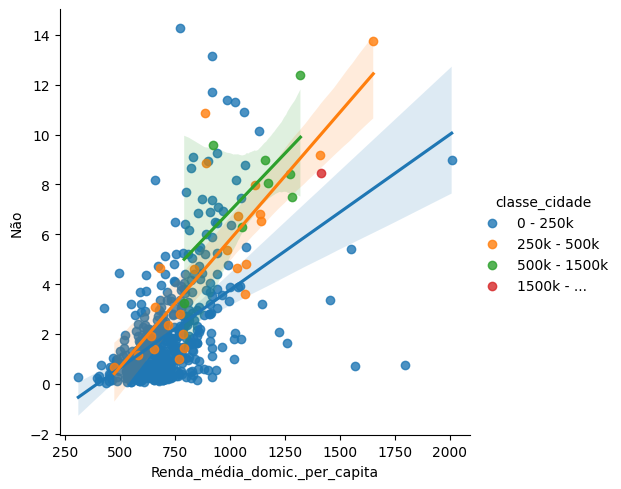

In [ ]:
sns.lmplot(x='Renda_média_domic._per_capita', y='Não', data=df_combined, hue='classe_cidade', fit_reg=True)

# **Análise Correlacional - Dist. profissional / Pop. total**

In [ ]:
df_combined = pd.merge(PopSp2022, medicos_dict, left_on='cod_ibge', right_on='Município')

In [ ]:
mascara = df_combined['cod_ibge'] != "355030" # Remove a cidade de São Paulo
df_combined = df_combined[mascara]

In [ ]:
x = df_combined['censo2022_x'].astype(int)
y = df_combined['Medicos_por_1000_hab']

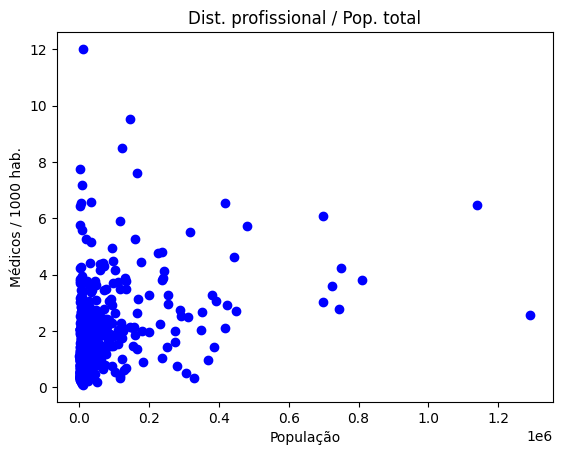

In [ ]:
plt.scatter(x, y, c ="blue")
plt.xlabel("População")
plt.ylabel("Médicos / 1000 hab.")
plt.title('Dist. profissional / Pop. total')
plt.show()

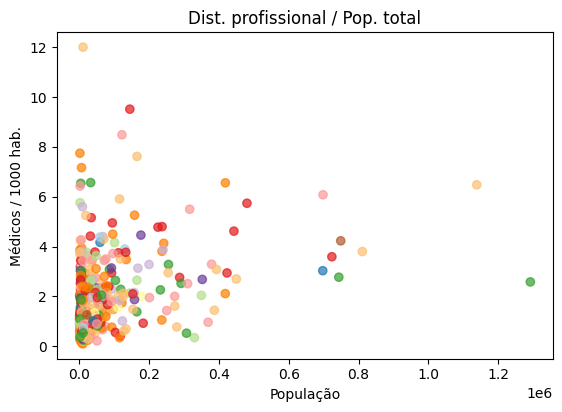

In [ ]:
import random
import matplotlib.cm as cm
fig = plt.figure()
fig.subplots_adjust(bottom=0.2)
ax = fig.add_subplot(111)

dS=np.random.normal(size=len(df_combined))

idx=random.sample(range(len(df_combined)),len(df_combined))

plt.xlabel("População")
plt.ylabel("Médicos / 1000 hab.")
plt.title('Dist. profissional / Pop. total')
plt.scatter(x,y,c=dS[idx],alpha=0.7,cmap=cm.Paired)
plt.show()

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))

sns.histplot(x, bins=10, kde=True, label='População', color='blue')
sns.histplot(y, bins=10, kde=True, label='Médicos / 1000 hab.', color='orange')

plt.xlabel('População')
plt.ylabel('Médicos / 1000 hab')

plt.title('Dist. profissional / Pop. total')
# Exibir o gráfico
plt.show()

# **Análise Correlacional - PairPlot**

In [ ]:
df_combined = pd.merge(PopSp2022, medicos_dict, left_on='cod_ibge', right_on='Município')
df_combined = pd.merge(df_combined, despesa_dict, left_on='cod_ibge', right_on='Município')
df_combined = pd.merge(df_combined, estabelecimentos_dict, left_on='cod_ibge', right_on='Município')
df_combined = pd.merge(df_combined, renda_dict, left_on='cod_ibge', right_on='Município')

<ipython-input-116-1d0786f7bc20>:3: FutureWarning: Passing 'suffixes' which cause duplicate columns {'censo2022_x'} in the result is deprecated and will raise a MergeError in a future version.
  df_combined = pd.merge(df_combined, estabelecimentos_dict, left_on='cod_ibge', right_on='Município')


In [ ]:
df_combined = df_combined.iloc[:, [0, 4, 9, 12, 15, 16]]
df_combined['classe_cidade'] = df_combined['censo2022_x'].apply(calcular_classe)
df_combined['classe_cidade'] = df_combined['classe_cidade'].map(mapper)

In [ ]:
correlation = df_combined.corr()
correlation

<ipython-input-119-db6e5524fe44>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = df_combined.corr()


,censo2022_x,Medicos_por_1000_hab,Valor_por_1000_hab,Estabelecimentos_por_1000_hab,Renda_média_domic._per_capita
censo2022_x,1.000000,0.168131,0.102334,0.009572,0.259709
Medicos_por_1000_hab,0.168131,1.000000,0.203034,0.339725,0.479723
Valor_por_1000_hab,0.102334,0.203034,1.000000,0.308670,0.108061
Estabelecimentos_por_1000_hab,0.009572,0.339725,0.308670,1.000000,0.464449
Renda_média_domic._per_capita,0.259709,0.479723,0.108061,0.464449,1.000000


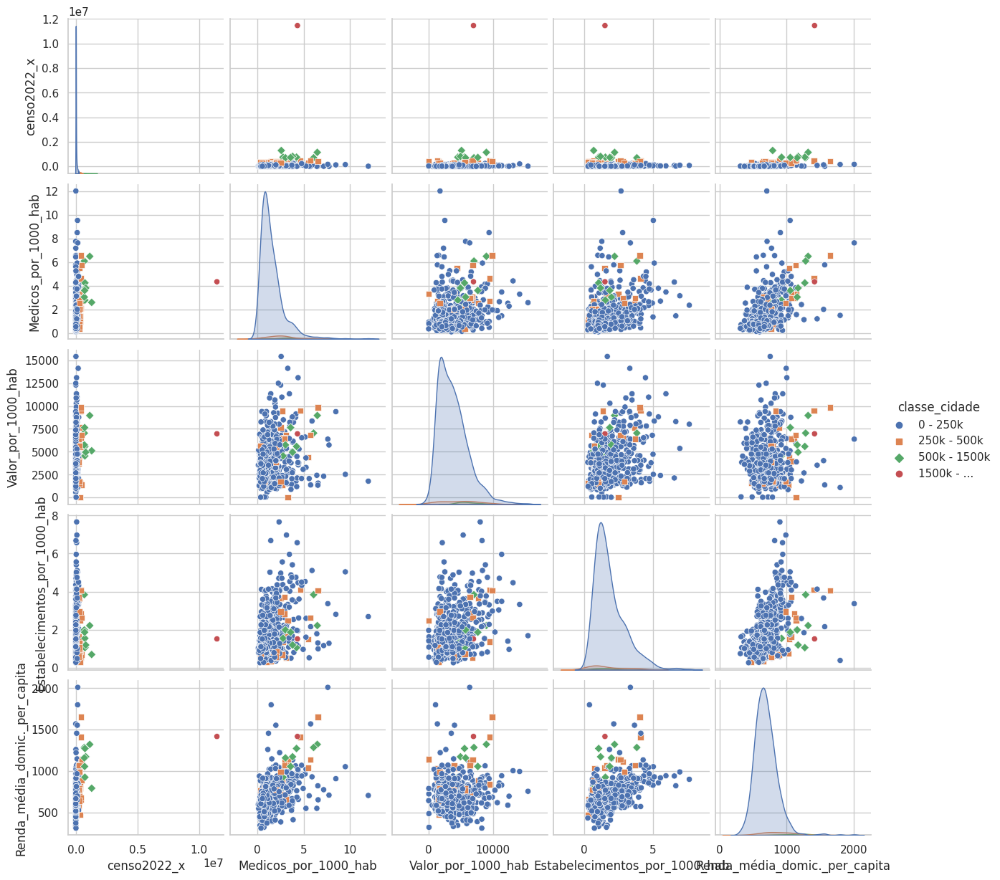

In [ ]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

sns.pairplot(df_combined, hue="classe_cidade", kind="scatter", markers=["o", "s", "D"])

plt.show()